In [ ]:
# import Genism package
from gensim.test.utils import common_corpus, common_dictionary
from gensim.models import HdpModel
from gensim import corpora
from gensim.utils import simple_preprocess
import pandas as pd
import os
import string
import numpy as np
import pandas as pd


In [ ]:
!pip install scanpy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 9.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 96.1/96.1 KB 4.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.2/88.2 KB 4.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 13.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.5/63.5 KB 2.5 MB/s eta 0:00:00
  Created wheel for umap-learn: filename=umap_learn-0.5.3-py3-none-any.whl size=82830 sha256=376b3789f819de982b280eb36f8f841e17be5f2274ed36a39589a9ab7d549e4e
  Stored in directory: /root/.cache/pip/wheels/f4/3e/1c/596d0a463d17475af648688443fa4846fef624d1390339e7e9
  Created wheel for session-info: filename=session_info-1.0.0-py3-none-any.whl size=8042 sha256=2cc537e558e273bc5c2a

In [ ]:
!pip install anndata

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import anndata as ad
import h5py
import numpy as np
import scanpy as sc

In [ ]:
mtx=sc.read_mtx("/content/matrix.mtx.gz")

In [ ]:
mtx=mtx.T
features=pd.read_csv('/content/features.tsv.gz', sep='\t', header=None)
barcodes=pd.read_csv('/content/barcodes.tsv.gz', sep='\t', header=None)
celltype=pd.read_csv('/content/P5931t_celltype_20220206.csv', sep=',', header=0)





In [ ]:
key_test=celltype['barcode'].tolist()
value_test=celltype['celltype'].tolist()
matching={}
for key in key_test:
    for value in value_test:
        matching[key]=value
        value_test.remove(value)
        break


In [ ]:
celltype_match=[]
for ii in barcodes.iloc[:,0]:
    if ii in matching.keys():
        celltype_match.append(matching[ii])
    else:
        celltype_match.append("Unknown")

barcodes['celltype']=celltype_match

In [ ]:
print(features.shape)
print(barcodes.shape)

(33538, 3)
(5861, 2)


In [ ]:
mtx.obs=barcodes
mtx.var=features

In [ ]:
mtx.obs

,0,celltype
0,AAACCTGAGCCAACAG-1,Plasma cells
1,AAACCTGAGGATATAC-1,Unknown
2,AAACCTGGTAAATACG-1,Epithelial cells
3,AAACCTGGTCTACCTC-1,Fibroblast
4,AAACCTGGTTAAGATG-1,Epithelial cells
...,...,...
5856,TTTGTCATCAATAAGG-1,Unknown
5857,TTTGTCATCATAACCG-1,Unknown
5858,TTTGTCATCCCATTAT-1,Unknown
5859,TTTGTCATCCCTAACC-1,Unknown


In [ ]:
mtx.var

,0,1,2
0,ENSG00000243485,MIR1302-2HG,Gene Expression
1,ENSG00000237613,FAM138A,Gene Expression
2,ENSG00000186092,OR4F5,Gene Expression
3,ENSG00000238009,AL627309.1,Gene Expression
4,ENSG00000239945,AL627309.3,Gene Expression
...,...,...,...
33533,ENSG00000277856,AC233755.2,Gene Expression
33534,ENSG00000275063,AC233755.1,Gene Expression
33535,ENSG00000271254,AC240274.1,Gene Expression
33536,ENSG00000277475,AC213203.1,Gene Expression


In [ ]:
#scv.pp.filter_and_normalize(mtx, min_shared_counts=20, n_top_genes=3000)
mtx.var_names_make_unique()  # th
sc.pp.filter_genes(mtx, min_cells=20)


/usr/local/lib/python3.9/dist-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [ ]:
## subset cells
mtx=mtx[mtx.obs.celltype != 'Unknown',:]

In [ ]:
mtx.shape

(3928, 13889)

In [ ]:
mtx.var['mt'] = mtx.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(mtx, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)


<ipython-input-17-ece7aec88ec7>:1: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  mtx.var['mt'] = mtx.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'


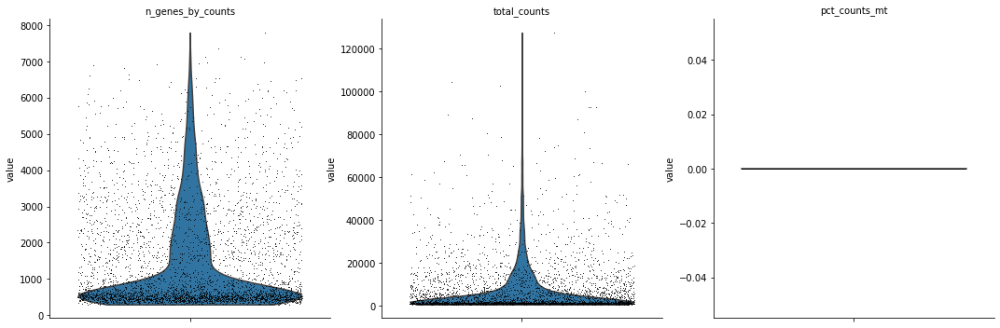

In [ ]:
sc.pl.violin(mtx, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)

In [ ]:
mtx.raw = mtx

In [ ]:
mtx.raw

In [ ]:
mtx.shape

(3928, 13889)

In [ ]:
dat_obj=mtx.raw[:, :]
dat=dat_obj.X.toarray()

In [ ]:
dat.shape

(3928, 13889)

In [ ]:
# generate BoW from the simulation data
doc_lists=[]
gene_names=dat_obj.var.iloc[:,1].tolist()
for ii in range(dat.shape[0]):
    rr=dat[ii,:]
    rr=rr.astype(int)
    ind=0
    doc=''
    for jj in rr:
        if jj>0:
            tmp=str(gene_names[ind])+" "
            doc=doc+tmp*int(jj)
        ind+=1
    doc_lists.append(doc)


doc_tokenized=[]
for ii in range(dat.shape[0]):
    rr=dat[ii,:]
    rr=rr.astype(int)
    ind=0
    doc=[]
    for jj in rr:
        if jj>0:
            for tt in range(jj):
                doc.append(str(gene_names[ind]))
        ind+=1
    doc_tokenized.append(doc)

In [ ]:
len(doc_tokenized[1])

13183

In [ ]:
dictionary = corpora.Dictionary()
BoW_corpus = [dictionary.doc2bow(doc, allow_update=True) for doc in doc_tokenized]


In [ ]:
BoW_corpus[1][0:15]

[(0, 3),
 (9, 5),
 (10, 1),
 (15, 2),
 (16, 1),
 (20, 1),
 (21, 3),
 (22, 1),
 (23, 1),
 (30, 1),
 (32, 22),
 (33, 2),
 (34, 2),
 (36, 2),
 (39, 1)]

In [ ]:
import time
time.clock = time.time

start_time = time.perf_counter()

# your code here

end_time = time.perf_counter()

In [ ]:
BoW_corpus

[[(0, 1),
  (1, 1),
  (2, 1),
  (3, 1),
  (4, 1),
  (5, 1),
  (6, 2),
  (7, 1),
  (8, 1),
  (9, 2),
  (10, 1),
  (11, 1),
  (12, 1),
  (13, 1),
  (14, 1),
  (15, 1),
  (16, 1),
  (17, 3),
  (18, 1),
  (19, 1),
  (20, 1),
  (21, 1),
  (22, 1),
  (23, 1),
  (24, 1),
  (25, 7),
  (26, 2),
  (27, 1),
  (28, 2),
  (29, 2),
  (30, 1),
  (31, 1),
  (32, 4),
  (33, 1),
  (34, 2),
  (35, 1),
  (36, 1),
  (37, 2),
  (38, 1),
  (39, 1),
  (40, 1),
  (41, 3),
  (42, 1),
  (43, 1),
  (44, 1),
  (45, 1),
  (46, 1),
  (47, 1),
  (48, 1),
  (49, 1),
  (50, 1),
  (51, 2),
  (52, 2),
  (53, 4),
  (54, 1),
  (55, 2),
  (56, 1),
  (57, 1),
  (58, 5),
  (59, 1),
  (60, 1),
  (61, 1),
  (62, 1),
  (63, 1),
  (64, 1),
  (65, 1),
  (66, 40),
  (67, 1),
  (68, 1),
  (69, 1),
  (70, 1),
  (71, 1),
  (72, 2),
  (73, 1),
  (74, 1),
  (75, 1),
  (76, 4),
  (77, 1),
  (78, 1),
  (79, 1),
  (80, 5),
  (81, 1),
  (82, 1),
  (83, 1),
  (84, 1),
  (85, 1),
  (86, 2),
  (87, 1),
  (88, 1),
  (89, 1),
  (90, 1),
  (91, 3

In [ ]:
dictionary

In [ ]:
from scipy.spatial import ConvexHull
import numpy as np

# Generate some random points
points = np.random.rand(10, 2)

# Calculate the convex hull of the points
hull = ConvexHull(points)

# Calculate the area of the convex hull
hull_area = hull.area

# Calculate the area of the original shape (using shoelace formula)
original_area = 0.5 * np.abs(np.dot(points[:, 0], np.roll(points[:, 1], 1)) - np.dot(points[:, 1], np.roll(points[:, 0], 1)))

# Calculate the area ratio
area_ratio = hull_area / original_area

print(f"Convex hull area: {hull_area:.2f}")
print(f"Original area: {original_area:.2f}")
print(f"Area ratio: {area_ratio:.2f}")

Convex hull area: 2.34
Original area: 0.06
Area ratio: 36.25
